# Galaxies: An interactive graduate course

## Chapter 2.5: SDSS: Morphology

#### (c) Benedikt Diemer, University of Maryland (based on similar notebooks by Andrey Kravtsov, University of Chicago)

In [1]:
import numpy as np
import scipy
import matplotlib.pyplot as plt
from routines import common as cmn

# Plotting settings
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Automatically reload code imported from changed python files
%reload_ext autoreload
%autoreload 2

In [2]:
from routines import obs_sdss

data = obs_sdss.loadSdssSpecSampleExtra()

print('Found %d galaxies with the following fields:' % (len(data)))
for k in data.dtype.names:
    print(k)

Found 672813 galaxies with the following fields:
ra
dec
mjd
plate
fiberID
class
z
zErr
rChi2
velDisp
velDispErr
extinction_u
extinction_g
extinction_r
extinction_i
extinction_z
fiberMag_u
fiberMag_g
fiberMag_r
fiberMag_i
fiberMag_z
modelMag_u
modelMag_g
modelMag_r
modelMag_i
modelMag_z
cmodelMag_u
cmodelMag_g
cmodelMag_r
cmodelMag_i
cmodelMag_z
phioffset_r
fracdeV_r
deVRad_r
deVRadErr_r
deVAB_r
deVABErr_r
deVPhi_r
lnLDeV_r
deVMag_r
deVMagErr_r
expRad_r
expRadErr_r
expAB_r
expABErr_r
expPhi_r
lnLExp_r
expMag_r
expMagErr_r
petroMag_u
petroMag_g
petroMag_r
petroMag_i
petroMag_z
petroRad_u
petroRad_g
petroRad_r
petroRad_i
petroRad_z
petroR50_r
petroR90_r
petroR50Err_r
petroR90Err_r
h_alpha_flux
h_alpha_flux_err
oiii_5007_flux
oiii_5007_flux_err
d4000
d4000_err
bptclass
lgm_tot_p50
sfr_tot_p50
objID
specObjID
K_u
K_g
K_r
K_i
K_z
color_ug
color_gr
color_ri
color_iz
DM
dL
dA
M_model_u
m_model_u
M_cmodel_u
m_cmodel_u
M_petro_u
m_petro_u
M_fiber_u
m_fiber_u
M_model_g
m_model_g
M_cmodel_g
m_cmod

### 2.5.2) Morphology and its correlation with other properties

Let's begin by defining two samples of galaxies, one nearby for well-resolved images and one for the overall sample population. As in the previous notebook, we limit the latter to not include the very lowest redshifts where the $V_{\rm max}$ corrections can become overly extreme. We also define a few variables that we will be using over and over again, as well as their plotting range.

In [3]:
mask_images = (data['dL'] < 150.0)
mask_sample = (data['z'] > 0.02)

# Magnitude
var_M = 'M_cmodel_r'
label_M = r'$M_{\rm cModel,r}$'
M_lo = -23.5
M_hi = -17.0

# Color
var_gr = 'color_gr'
label_gr = r'$g-r$'
gr_lo = 0.0
gr_hi = 1.0

# Surface brightness
var_mu = 'mu_petro_r'
label_mu = r'$\mu_{\rm r,50}\ ({\rm mag} / {\rm arcsec}^2)$'
mu_lo = 18.0
mu_hi = 24.5

# Concentration
var_c = 'c_90_50_r'
label_c = r'$c = R_{90\%} / R_{50\%}$'
c_lo = 1.5
c_hi = 3.6

# Axis ratio
var_ab = 'ab_best'
label_ab = r'$b/a$'
ab_lo = 0.0
ab_hi = 1.0

#### Magnitude and color

In the previous notebook, we saw that galaxy color is bimodal once we correct for luminosity effects using $V_{\rm max}$. Let's investigate this distribution a bit more by plotting it in 2D vs. magnitude. With our $V_{\rm max}$ correction, we cannot simply plot a number of galaxies per bin any more: we are not plotting a density in units of normalized number per $\Delta x$ and $\Delta y$ bin. We make the plot a little fancier by adding 1D histograms of magnitude and color on the sides.

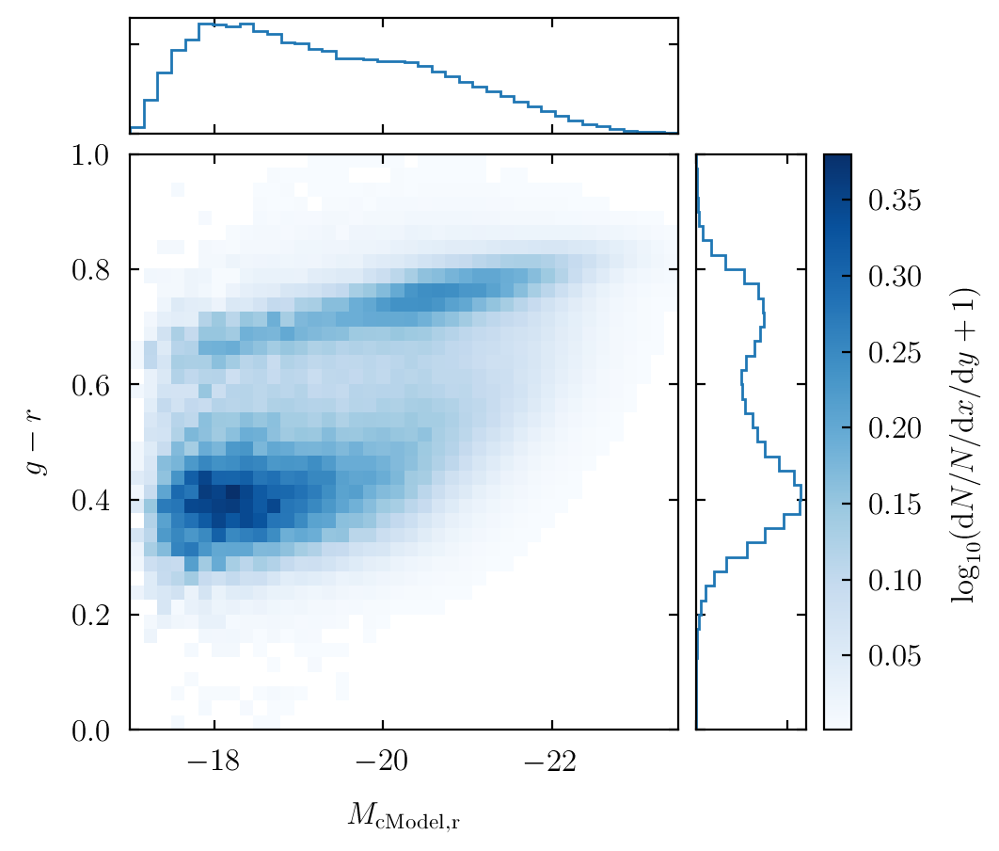

In [4]:
import matplotlib.gridspec as gridspec
import matplotlib as mpl

cmap = plt.get_cmap('Blues')
cmap.set_under('#FFFFFF')
vmin = 1E-3

data_use = data[mask_sample]
M = data_use[var_M]
gr = data_use[var_gr]

hist, _, _ = np.histogram2d(M, gr, bins = (40, 40), range = [[M_lo, M_hi], [gr_lo, gr_hi]], 
                                weights = data_use['1/Vmax'], density = True)
hist = np.log10(hist.T[::-1] + 1.0)
vmax = np.max(hist)

# Create panels. This is a bit tricky because we need space for the colorbar on the right. We create one panel for the 
# colorbar itself and one extra panel as a placeholder for the colorbar label.
fig = plt.figure(figsize = (5.5, 4.5))
gs = gridspec.GridSpec(2, 4, height_ratios = [0.2, 1.0], width_ratios = [1.0, 0.2, 0.05, 0.2])
plt.subplots_adjust(left = 0.14, right = 0.96, top = 0.98, bottom = 0.14, hspace = 0.06, wspace = 0.09)
p_main = fig.add_subplot(gs[4])	
p_hx = fig.add_subplot(gs[0], sharex = p_main)
p_hy = fig.add_subplot(gs[5], sharey = p_main)
p_cbar = fig.add_subplot(gs[6])

# Plot main 2D histogram
plt.sca(p_main)
plt.xlabel(label_M)
plt.ylabel(label_gr)
plt.xlim(M_lo, M_hi)
plt.ylim(gr_lo, gr_hi)
plt.gca().invert_xaxis()
plt.imshow(hist, extent = [M_lo, M_hi, gr_lo, gr_hi], interpolation = 'nearest', aspect = 'auto',
           cmap = cmap, vmin = vmin, vmax = vmax)

# Plot 1D histogram in x
plt.sca(p_hx)
plt.hist(M, bins = 40, range = [M_lo, M_hi], weights = data_use['1/Vmax'], density = True, histtype = 'step')
p_hx.tick_params(axis = 'x', labelbottom = False)
p_hx.tick_params(axis = 'y', labelleft = False)

# Plot 1D histogram in y
plt.sca(p_hy)
p_hy.tick_params(axis = 'y', labelleft = False)
p_hy.tick_params(axis = 'x', labelbottom = False)
plt.hist(gr, bins = 40, range = [gr_lo, gr_hi], weights = data_use['1/Vmax'], density = True, histtype = 'step', orientation='horizontal')

# We need to place the color bar in a separate panel to the right, otherwise it would overlap the y-histogram
plt.sca(p_cbar)
cb = mpl.colorbar.ColorbarBase(p_cbar, orientation = 'vertical', cmap = cmap, norm = mpl.colors.Normalize(vmin = vmin, vmax = vmax))
cb.set_label(r'$\log_{10} ({\rm d} N / N / {\rm d} x / {\rm d} y + 1)$', rotation = 90, labelpad = 10)

plt.show()

This distribution tells us a lot about galaxies: there is a blue-ish cloud mostly at lower luminosities, and a red population that tends to be luminous. But how do these populations correlate with morphology? Let's look at some visual examples with a new function that plots a grid of images selected to lie in certain bins of the $x$ and $y$ variables. The function can also plot density contours outlining the distribution in our 2D histogram above.

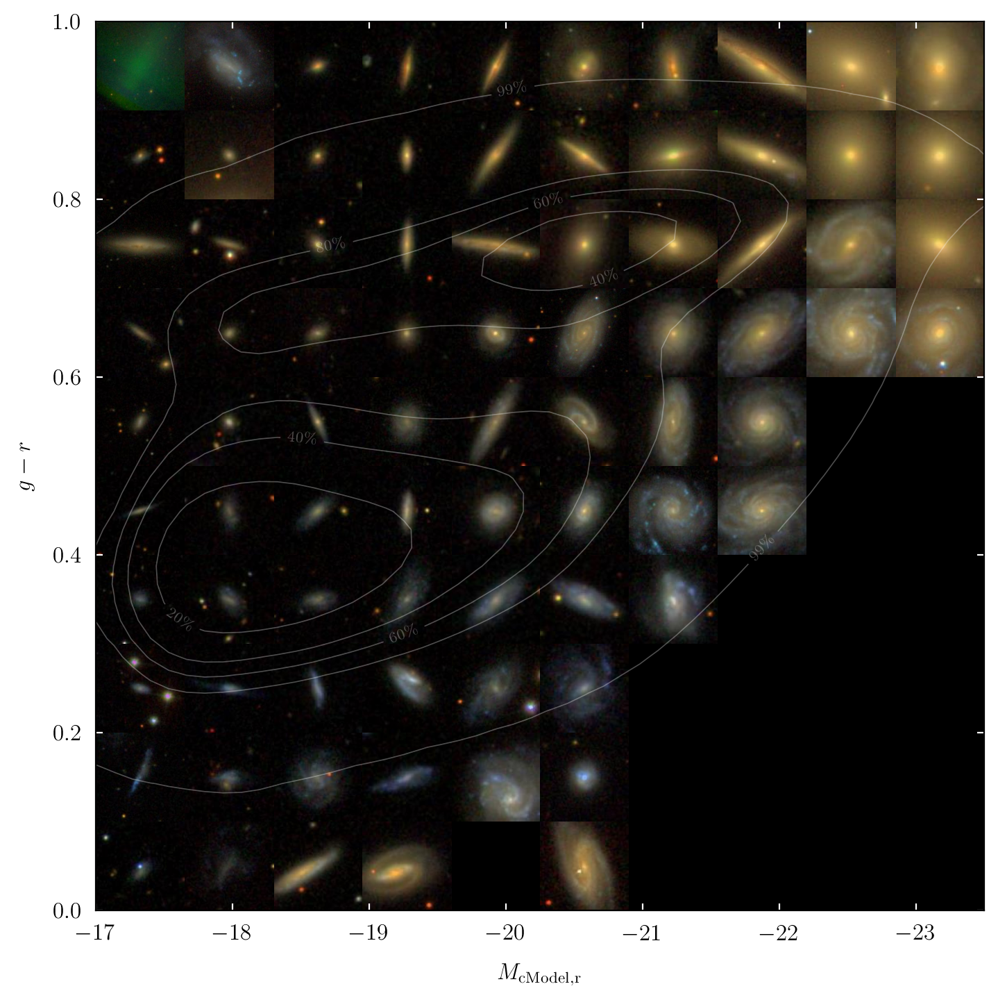

In [5]:
obs_sdss.imageCollageVariables(data, var_M, var_gr, label_M, label_gr, M_lo, M_hi, gr_lo, gr_hi, 
                    invert_x = True, n_bins_x = 10, n_bins_y = 10, 
                    mask_images = mask_images, image_size_kpc = 25.0,
                    plot_contours = True, mask_contours = mask_sample, 
                    save = False, show = True, fn_save = 'sdss_magnitude_color_images.pdf');

In the space of magnitude and color, morphology already separates out reasonably well, but by no means perfectly. For example, we do encounter quite a few red spirals, and the less massive galaxies seem to comprise a mixture of spirals and irregulars. 

#### Surface brightness

Given that ellipticals have prominent bulges, we might expect surface brightness to distinguish them from spirals. Let's try that.

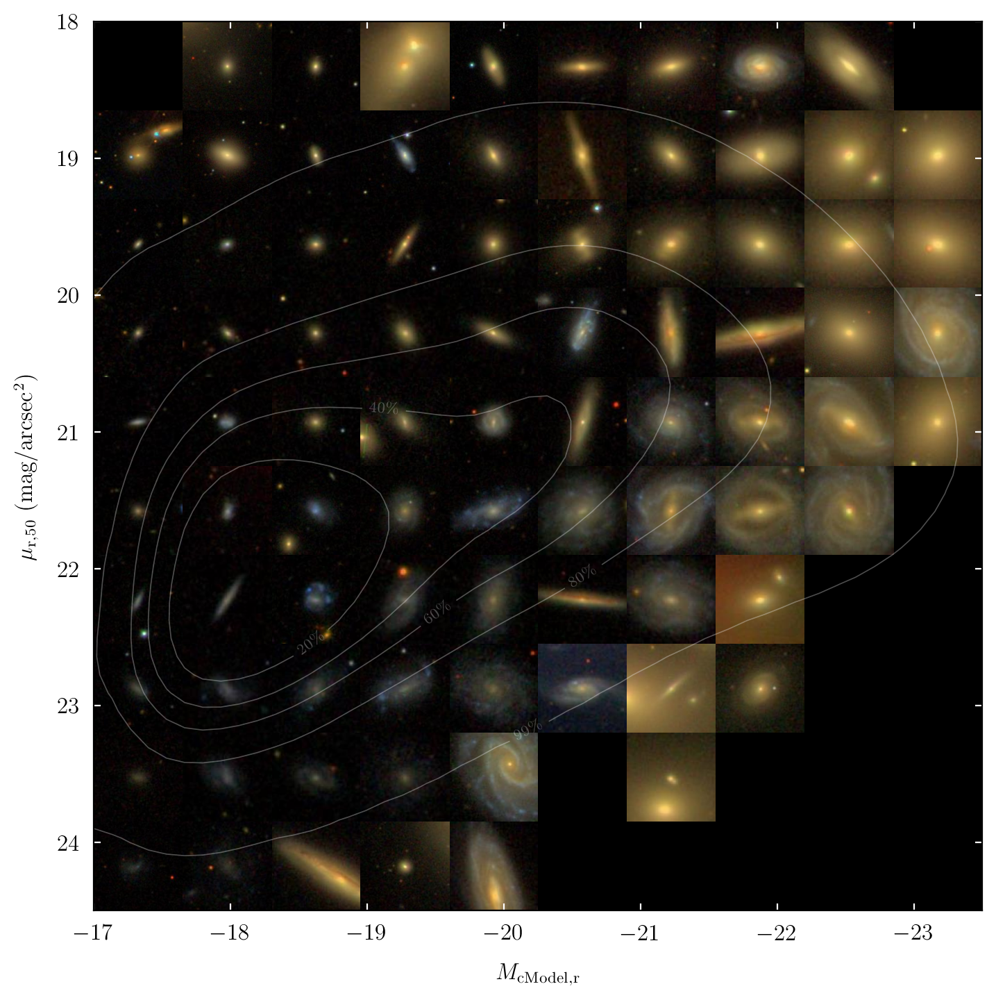

In [6]:
obs_sdss.imageCollageVariables(data, var_M, var_mu, label_M, label_mu, M_lo, M_hi, mu_lo, mu_hi, 
                    invert_x = True, invert_y = True, n_bins_x = 10, n_bins_y = 10, 
                    mask_images = mask_images, image_size_kpc = 25.0,
                    plot_contours = True, mask_contours = mask_sample);

The issue is that surface brightness correlates with magnitude, so more luminous galaxies also tend to have higher surface brightness. Moreover, some spirals (both face-on and edge-on) seem to have fairly high surface brightnesses. We also recall that surface brightness (as defined here) is mostly an observational quantity that depends on redshift when compared to the actual flux per physical area.

#### Concentration

To avoid the issues with surface brightness, we can define concentration as the ratio of two radii containing different fractions of the total light.

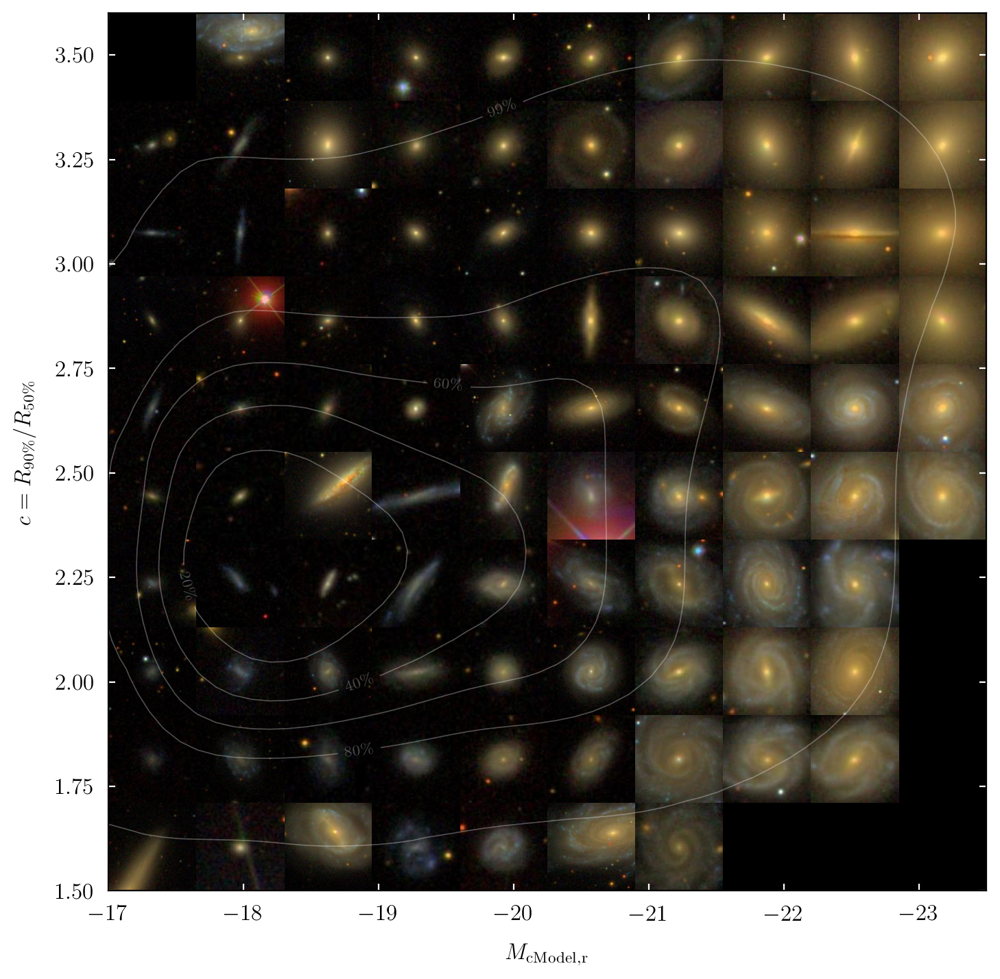

In [7]:
obs_sdss.imageCollageVariables(data, var_M, var_c, label_M, label_c, M_lo, M_hi, c_lo, c_hi, 
                    invert_x = True, n_bins_x = 10, n_bins_y = 10, 
                    mask_images = mask_images, image_size_kpc = 25.0,
                    plot_contours = True, mask_contours = mask_sample,
                    save = False, show = True, fn_save = 'sdss_magnitude_conc_images.pdf');

Concentration is NOT correlated much with magnitude, and it does seem to separate spirals from ellipticals pretty well: ellipticals have high concentration due to their large bulges. Some of the highest-concentration galaxies, however, seem to be edge-on spirals. 

We might wonder how concentration relates to surface brightness. These quantities are related but different, since concentration measures the relative brightness at different radii and surface brightness measures the normalization. For this plot, we additionally limit the sample to relatively luminous galaxies.

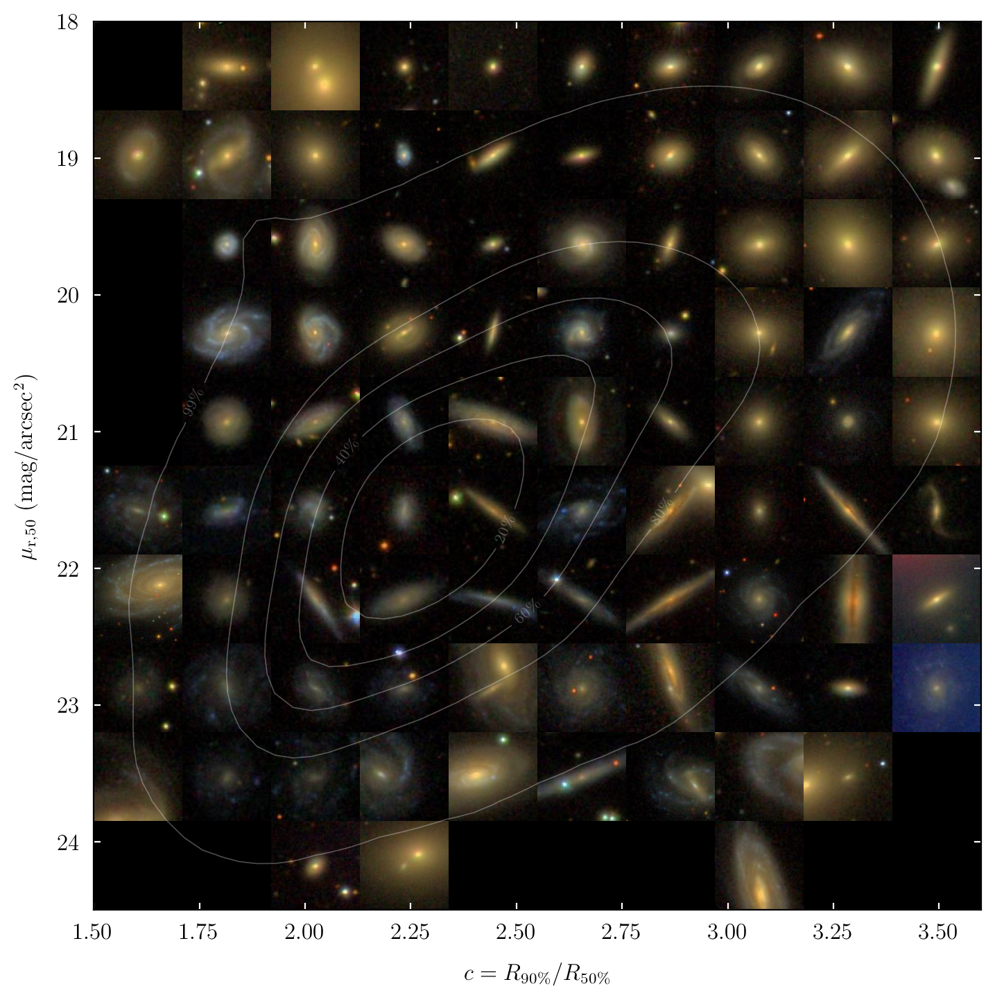

In [8]:
mask_im_m19 = (mask_images & (data['M_cmodel_r'] < -19.0))

obs_sdss.imageCollageVariables(data, var_c, var_mu, label_c, label_mu, c_lo, c_hi, mu_lo, mu_hi, 
                    invert_y = True, n_bins_x = 10, n_bins_y = 10, 
                    mask_images = mask_im_m19, image_size_kpc = 25.0,
                    plot_contours = True, mask_contours = mask_sample);

One more thing to understand about concentration is how it relates to color:

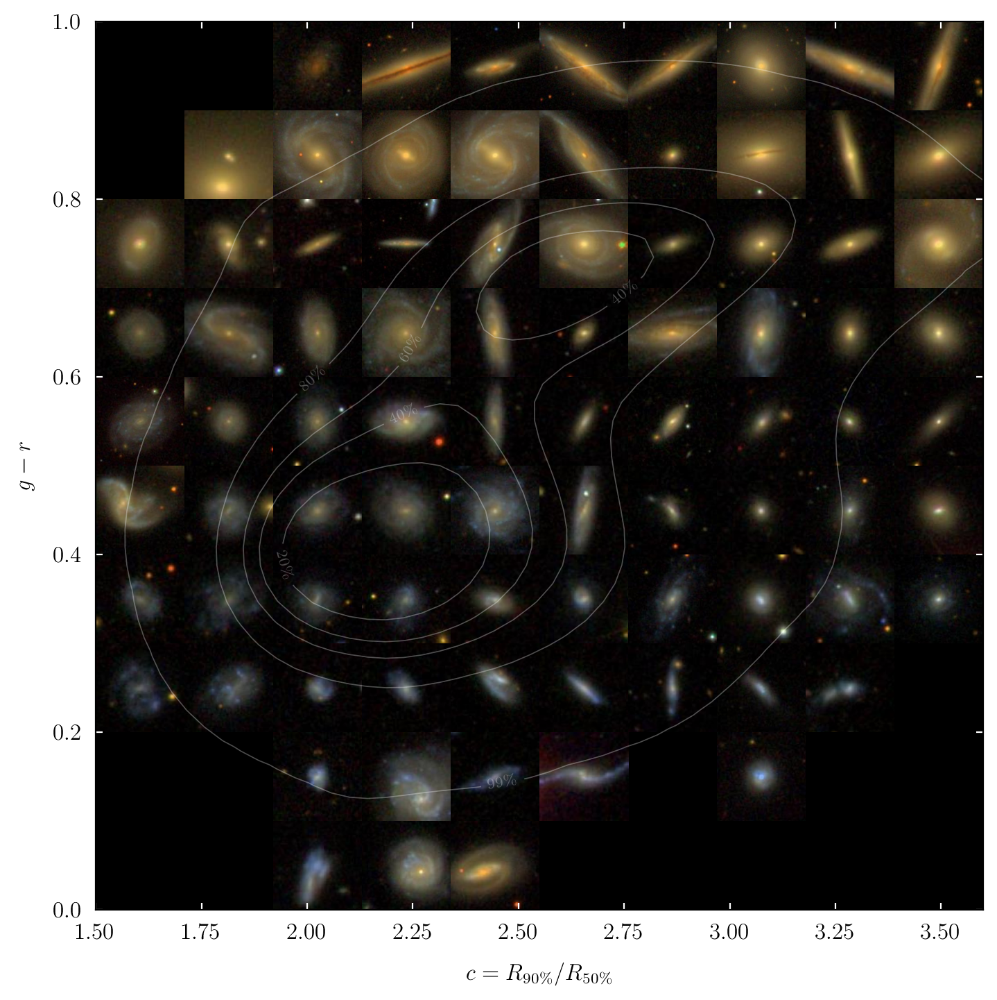

In [9]:
obs_sdss.imageCollageVariables(data, var_c, var_gr, label_c, label_gr, c_lo, c_hi, gr_lo, gr_hi, 
                    n_bins_x = 10, n_bins_y = 10, 
                    mask_images = mask_im_m19, image_size_kpc = 25.0,
                    plot_contours = True, mask_contours = mask_sample,
                    save = False, show = True, fn_save = 'sdss_conc_gr_images.pdf');

We see that the bimodality in color persists in the concentration-color distribution! These are, at face value, totally unrelated properties of galaxies. The bimodality is real in the sense that elliptical galaxies tend to be BOTH red and concentrated, whereas spirals tend to be BOTH blue and low-concentration.

#### Axis ratio

We know one good way to tell apart edge-on disks: they have low axis ratios, $b/a$. Let's plot those axis ratios against concentration:

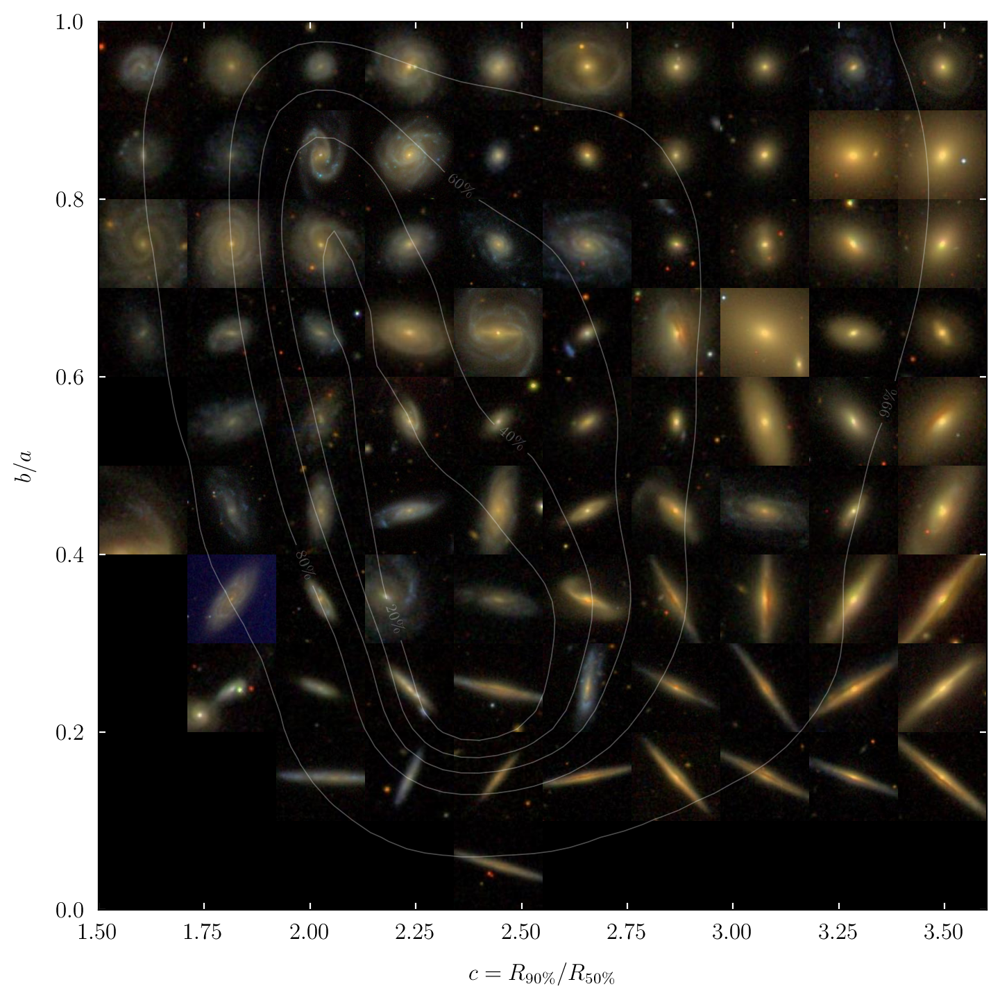

In [10]:
obs_sdss.imageCollageVariables(data, var_c, var_ab, label_c, label_ab, c_lo, c_hi, ab_lo, ab_hi, 
                    n_bins_x = 10, n_bins_y = 10, 
                    mask_images = mask_im_m19, image_size_kpc = 25.0,
                    plot_contours = True, mask_contours = mask_sample,
                    save = False, show = True, fn_save = 'sdss_conc_ba_images.pdf');

It seems clear that edge-on spirals cluster at high concentration and low $b/a$, which gives us a way of discerning them from intrinsically high-concentration galaxies. A cut on high concentration and high $b/a > 0.5$ seems to pick out ellipticals rather well!

#### A catalog with reliable morphology

[Meert et al. 2015](https://ui.adsabs.harvard.edu/abs/2015MNRAS.446.3943M/abstract) published an enhanced catalog of SDSS data. This catalog contains more sophisticated profile fits and thus magnitudes, and (most critically here) morphological classifications according to the method of [Huertas-Company et al. 2015](https://ui.adsabs.harvard.edu/abs/2011A%26A...525A.157H/abstract). The catalog limits the sample to slightly lower redshift though. You can find the files in the ``sdss_upenn`` sub-directory in the data folder. I have implemented a convenient function to load the data:

In [11]:
d_upenn = obs_sdss.loadUPennCatalog()

print('Found %d galaxies with the following fields:' % (len(d_upenn)))
for k in d_upenn.dtype.names:
    print(k)

Found 652773 galaxies with the following fields:
SexMag_r
SexMag_Err_r
SexHrad_r
SexSky_r
num_targets_r
num_neighborfit_r
AperRad_r
C_r
C_err_r
A_r
A_err_r
S_r
S_err_r
G_r
M20_r
extinction_r
dismod_r
kpc_per_arcsec_r
Vmax_r
SN_r
kcorr_r
SexMag_g
SexMag_Err_g
SexHrad_g
SexSky_g
num_targets_g
num_neighborfit_g
AperRad_g
C_g
C_err_g
A_g
A_err_g
S_g
S_err_g
G_g
M20_g
extinction_g
dismod_g
kpc_per_arcsec_g
Vmax_g
SN_g
kcorr_g
m_tot_r
m_aper_r
BT_r
r_tot_r
ba_tot_r
BT_aper_r
xctr_bulge_r
xctr_bulge_err_r
yctr_bulge_r
yctr_bulge_err_r
m_bulge_r
m_bulge_err_r
r_bulge_r
r_bulge_err_r
n_bulge_r
n_bulge_err_r
ba_bulge_r
ba_bulge_err_r
pa_bulge_r
pa_bulge_err_r
xctr_disk_r
xctr_disk_err_r
yctr_disk_r
yctr_disk_err_r
m_disk_r
m_disk_err_r
r_disk_r
r_disk_err_r
n_disk_r
n_disk_err_r
ba_disk_r
ba_disk_err_r
pa_disk_r
pa_disk_err_r
GalSky_r
GalSky_err_r
chi2nu_r
finalflag_r
autoflag_r
pyflag_r
pyfitflag_r
m_tot_g
m_aper_g
BT_g
r_tot_g
ba_tot_g
BT_aper_g
xctr_bulge_g
xctr_bulge_err_g
yctr_bulge_g
yctr_

Let's plot a collage of galaxies by morphological type according to their classification:

Elliptical (Ell)
[Found 782]


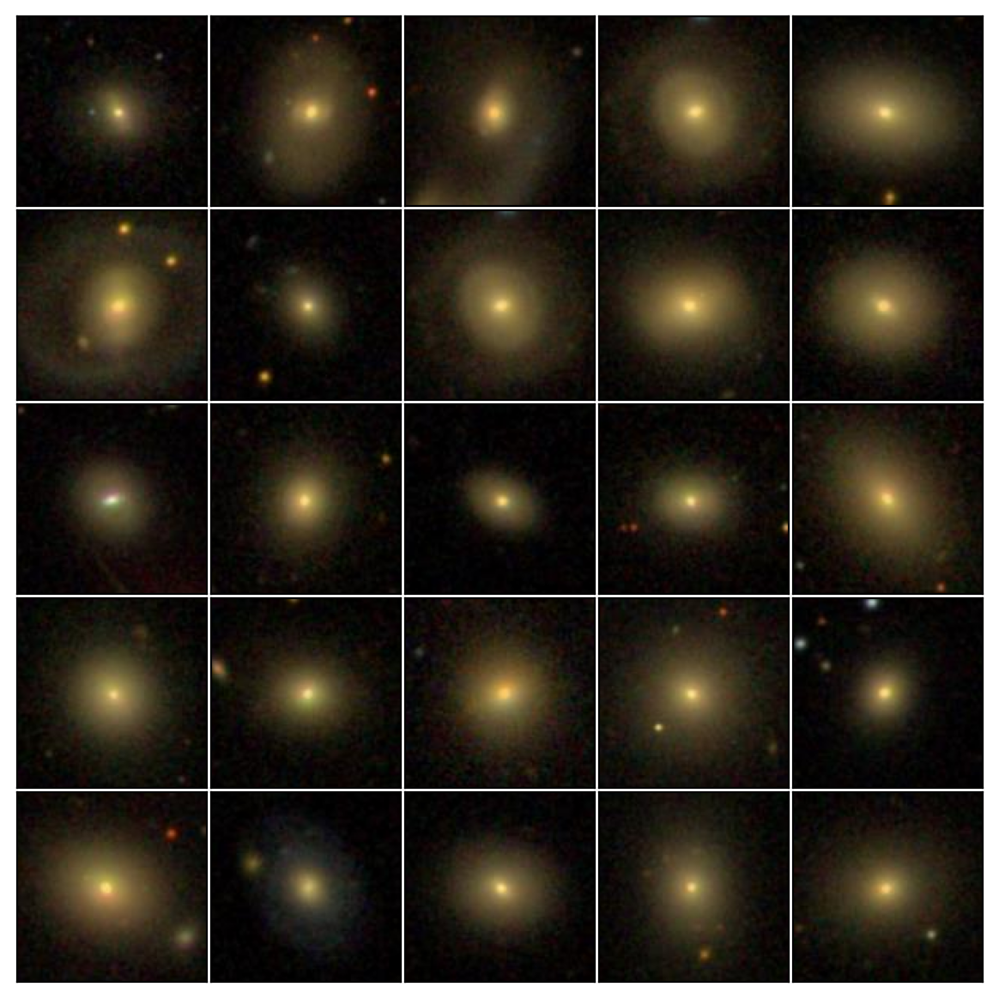

Lenticular (S0)
[Found 782]


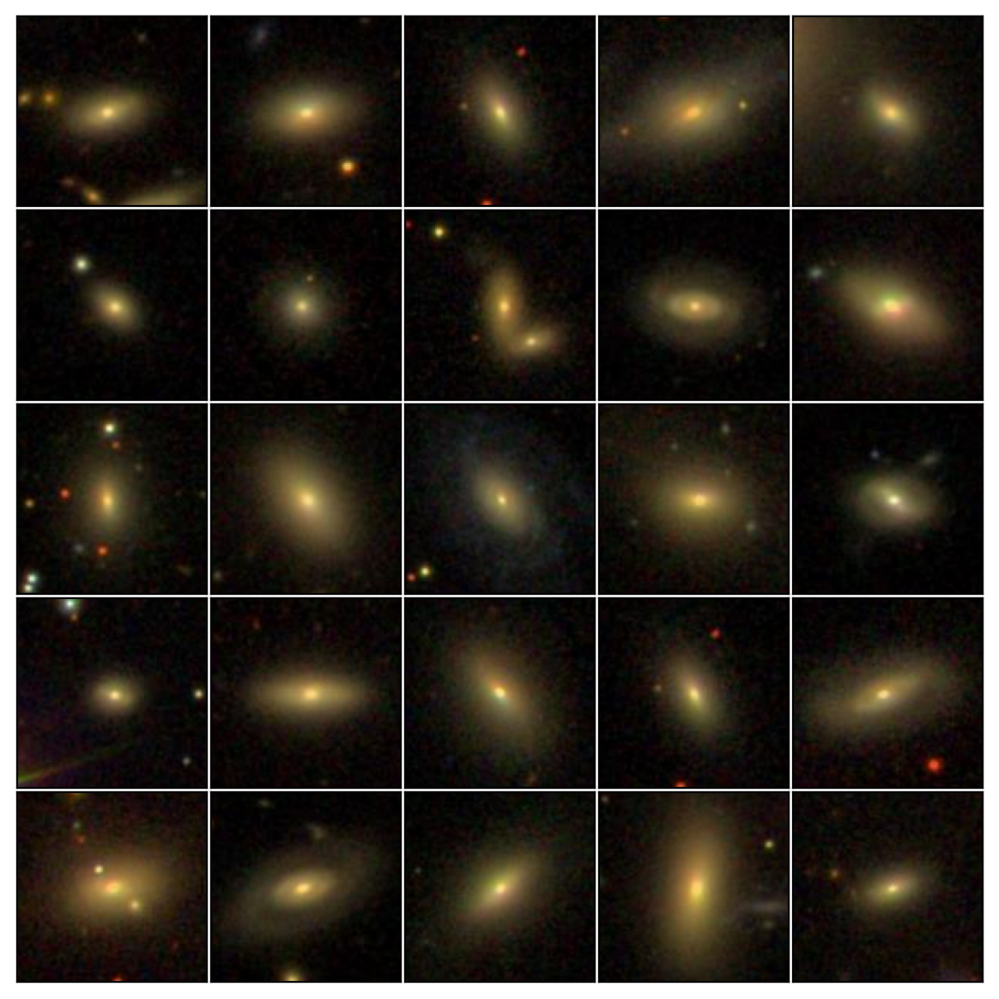

Spiral (Sab)
[Found 1155]


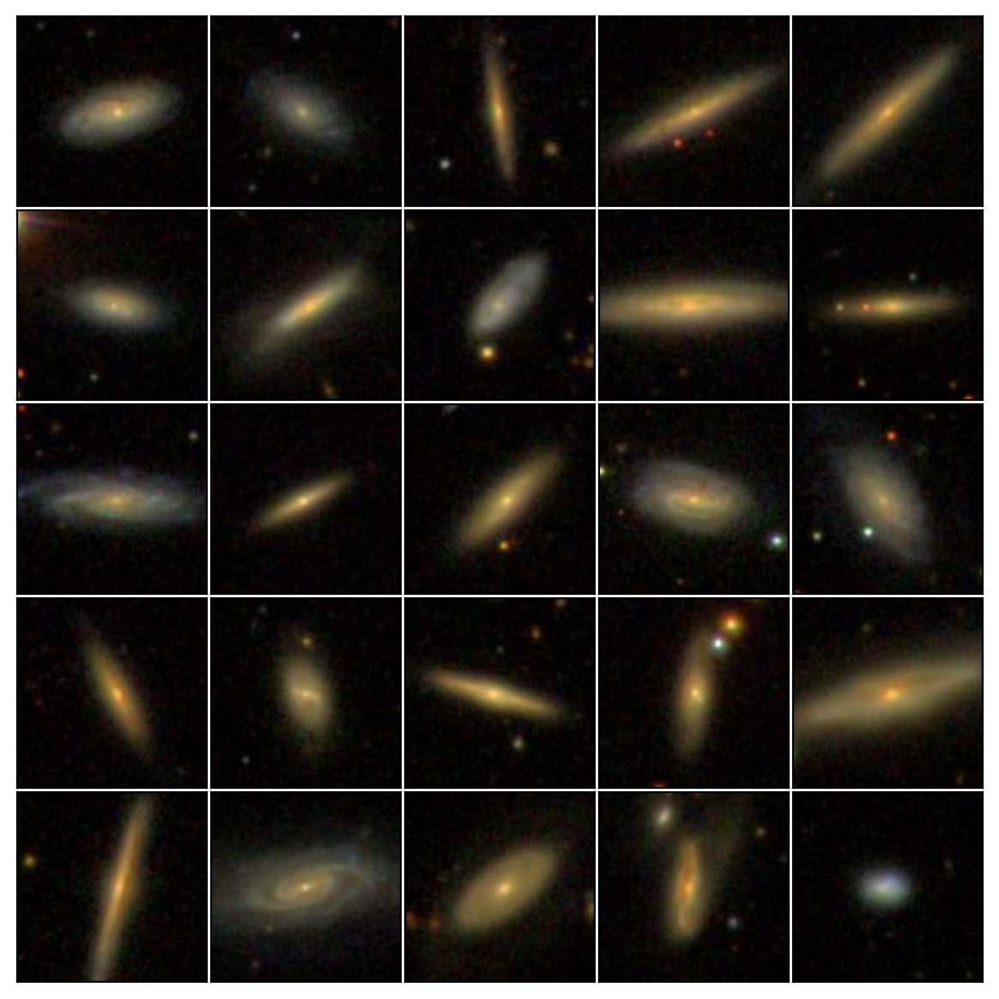

Spiral (Scd)
[Found 1672]


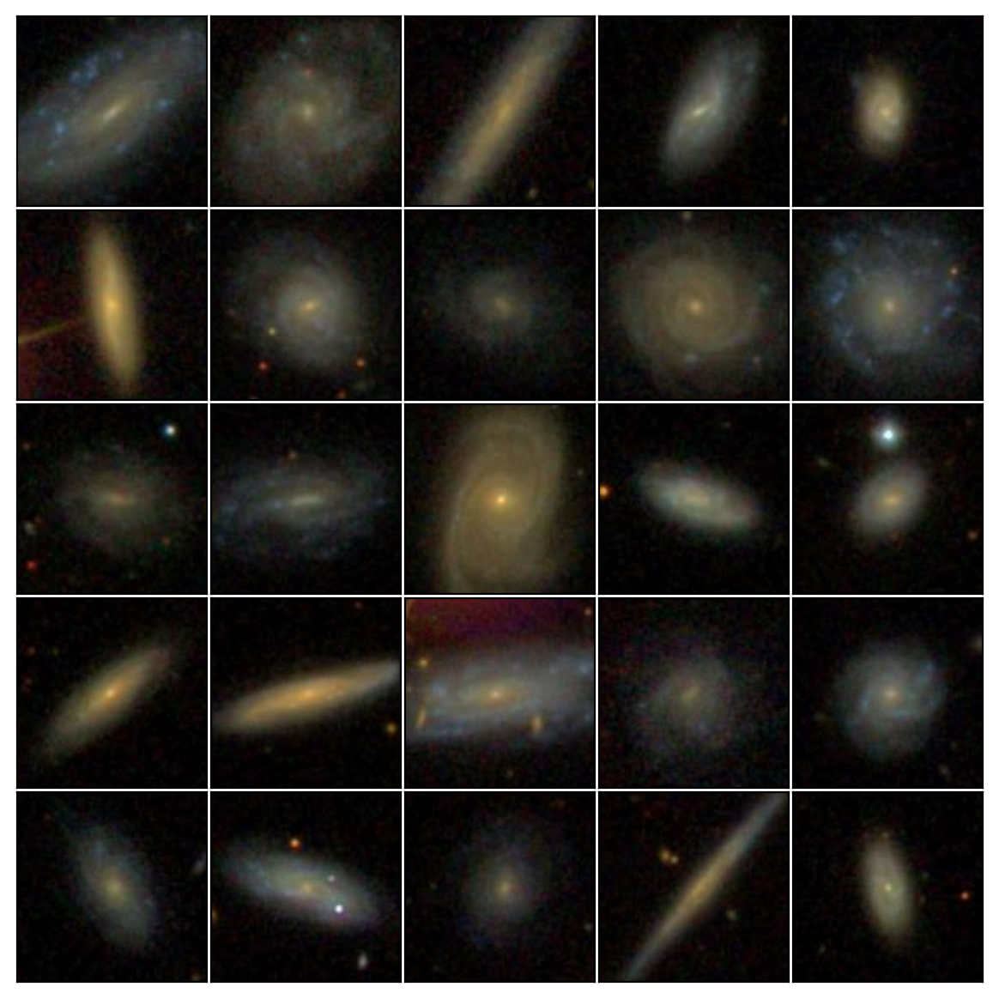

In [12]:
n_rows = 5
n_cols = 5
n_pix = 120
min_p = 0.7
np.random.seed(2025)

dL = cmn.cosmo.luminosityDistance(d_upenn['z']) / cmn.cosmo.h
mask = (dL >= 50.0) & (dL <= 150.0)
mask &= (d_upenn['m_tot_r'] < 16.0)

p_Ell = d_upenn['probaEll_h11']
p_S0 = d_upenn['probaS0_h11']
p_Sab = d_upenn['probaSab_h11']
p_Scd = d_upenn['probaScd_h11']

for i in range(4):
    
    if i == 0:
        print('Elliptical (Ell)')
        p = p_Ell
        mask_morph = mask & ((p > min_p) & (p > p_S0) & (p > p_Sab) & (p > p_Scd))
    elif i == 1:
        print('Lenticular (S0)')
        p = p_S0
        mask_morph = mask & ((p > min_p) & (p > p_Ell) & (p > p_Sab) & (p > p_Scd))
    elif i == 2:
        print('Spiral (Sab)')
        p = p_Sab
        mask_morph = mask & ((p > min_p) & (p > p_Ell) & (p > p_S0) & (p > p_Scd))
    elif i == 3:
        print('Spiral (Scd)')
        p = p_Scd
        mask_morph = mask & ((p > min_p) & (p > p_Ell) & (p > p_S0) & (p > p_Sab))
    
    if np.count_nonzero(mask_morph) == 0:
        continue
    print('[Found %d]' % np.count_nonzero(mask_morph))

    idxs_valid = np.where(mask_morph)[0]
    n_valid = len(idxs_valid)
    idxs = idxs_valid[np.random.randint(0, n_valid - 1, n_rows * n_cols)]
    d = d_upenn[idxs]

    obs_sdss.imageCollage(d, n_rows, n_cols, n_pix = n_pix, panel_size = 1.5);

The classification seems quite reliable indeed.

### 2.5.3) Morphology and dynamics: a preview

What fundamentally distinguishes disks and ellipticals? The dynamics of their stars. A disk corresponds to ordered motion, typically with high net angular momentum (though stars can also counter-rotate and thus offset the angular momentum of other stars), whereas the orbits in ellipticals (like in stellar halos) tend to be randomly oriented.

In disks, we can quantify the dynamics with a rotation curve, i.e., the average rotational velocity observed as a function of the distance from the center. Below we plot observations of the MW's rotation curve, taking data from the compilation of [Sofue 2020](https://ui.adsabs.harvard.edu/abs/2020Galax...8...37S/abstract).

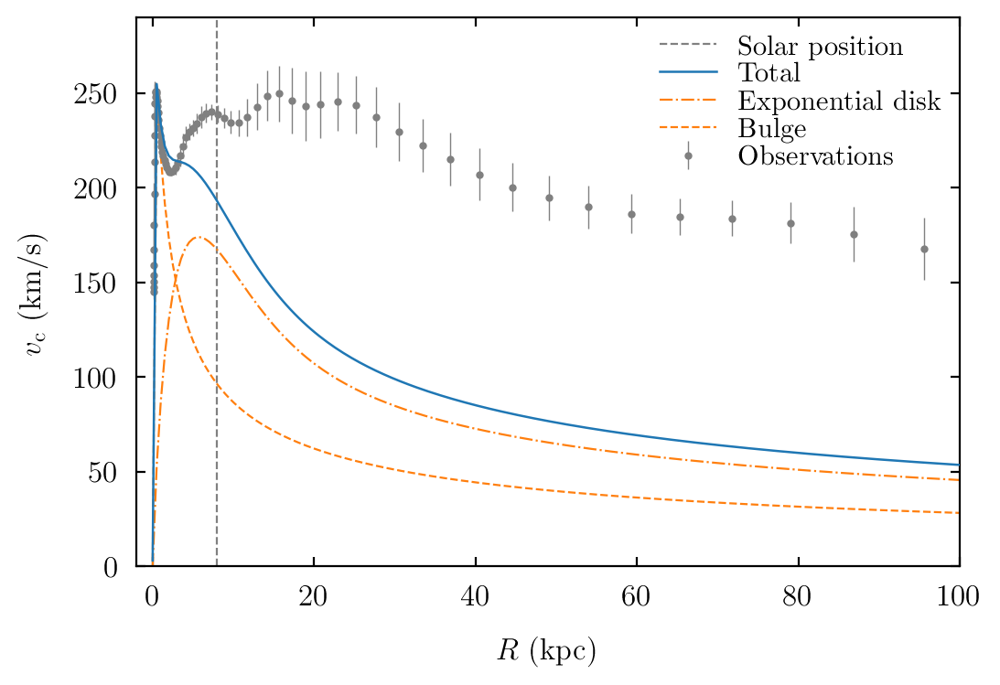

In [13]:
from colossus.utils import constants
from colossus.halo import profile_hernquist
from routines import obs_utils

# Disk data from Licquia & Newman 2016, bulge data from Ninkovic 2017
M_disk = 4.8E10
R_d = obs_utils.Rd_MW
M_bulge = 1.85E10
R_bulge = 0.3

# Load rotation curve data
d = np.loadtxt(cmn.data_dir + 'milky_way/rotation_curve_sofue_2020.txt', unpack = True)

# Calculate circular velocity due to exponential disk (Binney & Tremaine equation 2.165)
# Note that G in Colossus has units of kpc km^2 / Msun s^2
Sigma_0 = M_disk / (2.0 * np.pi * R_d**2)
R = np.linspace(1E-5, 100.0, 200)
y = R / 2.0 / R_d
I_0 = scipy.special.iv(0, y)
I_1 = scipy.special.iv(1, y)
K_0 = scipy.special.kn(0, y)
K_1 = scipy.special.kn(1, y)
V_disk = np.sqrt(4.0 * np.pi * constants.G * Sigma_0 * R_d * y**2 * (I_0 * K_0 - I_1 * K_1))

# Bulge. Create a Hernquist profile and normalize it to have the desired total mass
h = cmn.cosmo.h
prf = profile_hernquist.HernquistProfile(rhos = 1.0, rs = R_bulge * h)
M_norm = prf.enclosedMass(1000.0) / h
prf = profile_hernquist.HernquistProfile(rhos = M_bulge / M_norm, rs = R_bulge * h)
V_bulge = prf.circularVelocity(R * h)

# Compute total circular velocity curve
V_tot = np.sqrt(V_bulge**2 + V_disk**2)

# Plot
plt.figure(figsize = (6.0, 4.0))
plt.xlabel(r'$R\ ({\rm kpc})$')
plt.ylabel(r'$v_{\rm c}\ ({\rm km} / {\rm s})$')
plt.axvline(8.0, ls = '--', color = 'gray', lw = 0.8, label = r'$\mathrm{Solar\ position}$')
plt.errorbar(d[0], d[1], d[2], fmt = 'o', ms = 2.0, color = 'gray', lw = 0.5, label = r'$\mathrm{Observations}$')
plt.plot(R, V_tot, '-', label = r'$\mathrm{Total}$', lw = 0.9, zorder = 100)
plt.plot(R, V_disk, '-.', label = r'$\mathrm{Exponential\ disk}$', lw = 0.8, color = cmn.color_cycle[1])
plt.plot(R, V_bulge, '--', label = r'$\mathrm{Bulge}$', lw = 0.8, color = cmn.color_cycle[1])
plt.xlim(-2.0, 100.0)
plt.ylim(0.0, 290.0)
plt.legend(labelspacing = 0.1, borderpad = 0.1)
plt.show()

The bulge + disk potential matches well at small radii, but it cannot explain the rotation velocities beyond the Solar circle! This is one of the strongest motivations for dark matter.